# Домашка 
---------------------------------------

tldr:
    
* Выбрать архитектуру из рассказанных NST, pix2pix, CycleGAN$^1$
* Подберите к ней задачу, чтобы она вам нравилась
* Подберите еще одну задачу, которая уже решена (если не NST)
* Повторите решение, которое уже есть$^2$ (если не NST)
* Решите свою задачу

---------------------------------------
1. Расположены в порядке возрастания сложности и крутизны
2. Поверьте если вы сделаете этот пункт следующий будет в *разы* легче

## Если вы выбрали Neural Style Transfer
---------------------------------------
Тут все довольно просто на первый и на второй взгляд. Поэтому недосотаточно просто написать свою функцию потерь и сдать ноутбук. Если вы хотите приличных баллов, то у вас есть две опции:


1. Вы разделяете картинку на две части и переносите на них разные стили. <p><span style="color:red">Нельзя просто взять и два раза применить обычную архитектуру сначала к одной чати картинки, а потом к другой.</span></p> От вас ожидается, что вы отдадите нейросети два картинки стиля и она внутри себя(скорее внутри лосс функции) разделит выходную картинку на две части и к одной части применит один стиль, а к другой - второй. 

2. Вы переносите *одновременно* два стиля на одну картинку контента.
<p><span style="color:red">Нельзя просто взять и два раза применить обычную архитектуру сначала с одним стилем, а потом с другим.</span></p>
От вас ожидается, что вы модифицируете модель(скорее лосс модели) для того, чтобы два стиля учитывались с разными весами. 

## Если вы выбрали pix2pix
---------------------------------------------
Здесь от вас ожидается, что вы реализуете свою архитектуру для pix2pix модели. Пожалуйста не копируйте код из открытых репозиториев. Этот факт очень легко обнаружить. Перед тем, как приступить проверьте, что обе задачи, которые вы выбрали влезают на вашу видеокарту или на карту Google Colab. Если они не влезают, но вам все равно очень хочется, то вы можете израсходовать все безплатные триалы облаков(Google, Amazon, .. etc) во вселенной. 

## Если вы выбрали CycleGAN
--------------------------------------------
Здесь от вас ожидается, что вы реализуете свою архитектуру для CycleGAN модели. Пожалуйста не копируйте код из открытых репозиториев. Этот факт очень легко обнаружить. Перед тем, как приступить проверьте, что обе задачи, которые вы выбрали влезают на вашу видеокарту или на карту Google Colab. CycleGAN в этом смысле хуже, чем pix2pix, он ест больше памяти. Если они не влезают, но вам все равно очень хочется, то вы можете израсходовать все беcплатные триалы облаков(Google, Amazon, .. etc) во вселенной. 

## Remarks:
-----------------------------------------

* Это задание нужно для того, чтобы вы наступили на все грабли, что есть. Узнали об их существовании и научились обходить. Посмотрели на неработающие модели и поняли, что все тлен. Изгуглили весь интернет и в конце заставили это все работать. Поверьте, оно того стиот. Не откладывайте это задание на ночь перед сдачей, так как весь смысл \*пуф\* улетучится.

* У вас два союзника в этой борьбе:
    1. Оригинальная статья, те психи, что ее писала как то заставили свою модель работать. Их мысли, которыми они спроводили свое детище, позволят вам написать свой вариант алгоритма. 
    2. Гугл, он знает ответы на почти все ваши вопросы, но у него есть две ипостаси одна простая в обещении и вы все ее занаете(русскоязычная), а есть еще одна, которая кусается, но знает больше(англоязычная). Если не знаете языва - учите на ходу :)
    
* На самом деле у вас есть еще один союзник, это ментор проекта(или лектор или семинарист). Его ресурсом нужно пользоваться в ситуации, в которой вы не можете(занчит попытались и не вышло) найти ответов, используя Гугл и статью.

* Сдавать это все нужно следующим образом. Код вы кидаете на github и отправляете ссылку туда, куда вам сказали(в телеграм, степик или еще куда-то)

In [0]:
import string
import numpy as np
import glob
import random
import os
from skimage import io

from PIL import Image
from pathlib import Path

from torchvision import transforms
from torch.optim import lr_scheduler
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import save_image

import torch
import torch.nn.functional as F
import torch.nn as nn
import itertools

import time
import matplotlib.pyplot as plt

In [2]:
!nvidia-smi

Mon Jun 15 17:57:04 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.36.06    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8    31W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


Загружаем нужный датасет и распаковываем его

In [5]:
# ! wget https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip
# ! wget https://www.kaggle.com/arnaud58/horse2zebra/download
! wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1ScM8c3EqtGOq0gPOuEgDVoUjI0UKfXfI' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1ScM8c3EqtGOq0gPOuEgDVoUjI0UKfXfI" -O hairdye.zip && rm -rf /tmp/cookies.txt

--2020-06-15 17:57:36--  https://docs.google.com/uc?export=download&confirm=DM3M&id=1ScM8c3EqtGOq0gPOuEgDVoUjI0UKfXfI
Resolving docs.google.com (docs.google.com)... 142.250.98.138, 142.250.98.101, 142.250.98.102, ...
Connecting to docs.google.com (docs.google.com)|142.250.98.138|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-08-88-docs.googleusercontent.com/docs/securesc/n09n2ner7ad9ss40vcbfdg9f3hb97t2l/654nit5cu4f1v4e31djmqq307smjkavi/1592243850000/09599240158229350452/08461681577872739213Z/1ScM8c3EqtGOq0gPOuEgDVoUjI0UKfXfI?e=download [following]
--2020-06-15 17:57:37--  https://doc-08-88-docs.googleusercontent.com/docs/securesc/n09n2ner7ad9ss40vcbfdg9f3hb97t2l/654nit5cu4f1v4e31djmqq307smjkavi/1592243850000/09599240158229350452/08461681577872739213Z/1ScM8c3EqtGOq0gPOuEgDVoUjI0UKfXfI?e=download
Resolving doc-08-88-docs.googleusercontent.com (doc-08-88-docs.googleusercontent.com)... 173.194.217.132, 2607:f8b0:400c:c13::84
Connectin

In [6]:
!pip install pyunpack

In [0]:
from pyunpack import Archive
Archive('hairdye.zip').extractall('/content/')

Создаем класс для перевода .jpg картинок в тензоры


In [0]:
class ImagePrepare(Dataset):
    """
    Датасет с картинками, который паралельно подгружает их из папок
    производит скалирование и превращение в торчевые тензоры
    """
    def __init__(self, root, mode):
        super().__init__()
        self.mode = mode

        self.unaligned = False


        self.files_A = sorted(glob.glob(os.path.join(root, '%sA' % mode) + '/*.*'))
        self.files_B = sorted(glob.glob(os.path.join(root, '%sB' % mode) + '/*.*'))


    def __getitem__(self, index):
        if self.mode == 'train':
            transform = transforms.Compose([  
                          transforms.CenterCrop((256, 256)),
                          transforms.ToTensor(),
                          transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
            ])
        else:
            transform = transforms.Compose([  
                          transforms.Resize((256, 256)),
                          transforms.ToTensor(),
                          transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
            ])


        item_A = transform(Image.open(self.files_A[index % len(self.files_A)]).convert('RGB'))

        if self.unaligned:
            item_B = transform(Image.open(self.files_B[random.randint(0, len(self.files_B) - 1)]).convert('RGB'))
        else:
            item_B = transform(Image.open(self.files_B[index % len(self.files_B)]).convert('RGB'))

        return {'A': item_A,
                'B': item_B}

                      
    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

In [0]:
DIR = Path('hairdye')
data_train = ImagePrepare(DIR, mode='train')
dataloader = DataLoader(data_train, batch_size=5, shuffle=True)

In [0]:
data_test = ImagePrepare(DIR, mode='test')
dataloader_test = DataLoader(data_test, batch_size=1, shuffle=False)

Изображения для тестирования во время обучения

In [0]:
test_real_A_data_2 = data_test.__getitem__(-1)['A'].unsqueeze(0)
test_real_B_data_2 = data_test.__getitem__(-1)['B'].unsqueeze(0)

Классы, используемые при создании генератора и дискриминатора

In [0]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        conv_block = [nn.ReflectionPad2d(1),
                      nn.Conv2d(in_features, in_features, 3),
                      nn.InstanceNorm2d(in_features),
                      nn.ReLU(inplace=True),
                      nn.ReflectionPad2d(1),
                      nn.Conv2d(in_features, in_features, 3),
                      nn.InstanceNorm2d(in_features)]

        self.conv_block = nn.Sequential(*conv_block)

    def forward(self, x):
        return x + self.conv_block(x)

In [0]:
class Generator(nn.Module):
    def __init__(self, input_nc, output_nc, n_blocks=9):
        super(Generator, self).__init__()

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, 64, kernel_size=7, padding=0),
                 nn.InstanceNorm2d(64),
                 nn.ReLU(True)]


        model += [nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
                  nn.InstanceNorm2d(128),
                  nn.ReLU(True)]
        model += [nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
                  nn.InstanceNorm2d(256),
                  nn.ReLU(True)]


        for i in range(n_blocks): # add ResNet blocks
            model += [ResidualBlock(256)] 


        model += [nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
                  nn.InstanceNorm2d(128),
                  nn.ReLU(True)]
        model += [nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
                  nn.InstanceNorm2d(64),
                  nn.ReLU(True)]

                  
        model += [nn.ReflectionPad2d(3),
                  nn.Conv2d(64, output_nc, kernel_size=7, padding=0),
                  nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [0]:
class PatchGAN(nn.Module):
    def __init__(self, input_nc):
        super(PatchGAN, self).__init__()

        sequence = [nn.Conv2d(input_nc, 64, kernel_size=4, stride=2, padding=1),
                    nn.LeakyReLU(0.2, True)]


        sequence += [nn.Conv2d(64 * 1, 64 * 2, kernel_size=4, stride=2, padding=1),
                    nn.InstanceNorm2d(64 * 2),
                    nn.LeakyReLU(0.2, True)]
        sequence += [
                nn.Conv2d(64 * 2, 64 * 4, kernel_size=4, stride=2, padding=1),
                nn.InstanceNorm2d(64 * 4),
                nn.LeakyReLU(0.2, True)]


        sequence += [nn.Conv2d(64 * 4, 64 * 8, kernel_size=4, stride=1, padding=1),
                     nn.InstanceNorm2d(64 * 8),
                     nn.LeakyReLU(0.2, True)]

        sequence += [nn.Conv2d(64 * 8, 1, kernel_size=4, stride=1, padding=1)] 

        self.model = nn.Sequential(*sequence)

    def forward(self, x):
        x =  self.model(x)
        return x

Класс для хранения изображений, которые подаются для обучения дискриминатора. Для улучшения скорости обучения.

In [0]:
class ImageBuffer():
    def __init__(self, max_size=50):
        assert (max_size > 0)
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        to_return = []
        for element in data.data:
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if random.uniform(0,1) > 0.5:
                    i = random.randint(0, self.max_size-1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        return torch.cat(to_return)

In [0]:
def to_np(x):
    return x.data.cpu().numpy()

In [0]:
def plot_train_result(real_image, gen_image, recon_image, epoch, fig_size=(8, 5)):
    fig, axes = plt.subplots(2, 3, figsize=fig_size)

    imgs = [to_np(real_image[0]), to_np(gen_image[0]), to_np(recon_image[0]),
            to_np(real_image[1]), to_np(gen_image[1]), to_np(recon_image[1])]
    for ax, img in zip(axes.flatten(), imgs):
        ax.axis('off')
        ax.set_adjustable('box')
        # Scale to 0-255
        img = img.squeeze()
        img = (((img - img.min()) * 255) / (img.max() - img.min())).transpose(1, 2, 0).astype(np.uint8)
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    title = 'Epoch {0}'.format(epoch + 1)
    fig.text(0.5, 0.04, title, ha='center', fontsize=12, color='white')

    plt.show()

In [0]:
netG_A2B = Generator(3, 3)
netG_B2A = Generator(3, 3)
netD_A = PatchGAN(3)
netD_B = PatchGAN(3)


netG_A2B.cuda()
netG_B2A.cuda()
netD_A.cuda()
netD_B.cuda()

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [27]:
netG_A2B.load_state_dict(torch.load('drive/My Drive/netG_A2B_hair.pth'))
netG_B2A.load_state_dict(torch.load('drive/My Drive/netG_B2A_hair.pth'))
netD_A.load_state_dict(torch.load('drive/My Drive/netD_A_hair.pth'))
netD_B.load_state_dict(torch.load('drive/My Drive/netD_B_hair.pth'))

<All keys matched successfully>

In [0]:
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

In [0]:
optimizer_G = torch.optim.Adam(itertools.chain(netG_A2B.parameters(), netG_B2A.parameters()),
                                lr=2e-4, betas=(0.5, 0.999))
optimizer_D_A = torch.optim.Adam(netD_A.parameters(), lr=2e-4, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(netD_B.parameters(), lr=2e-4, betas=(0.5, 0.999))

In [0]:
scheduler = torch.optim.lr_scheduler.StepLR(optimizer_G, step_size=30, gamma=0.5)

In [0]:
fake_A_buffer = ImageBuffer()
fake_B_buffer = ImageBuffer()

In [0]:
def train(n_epochs):
    netG_A2B.train()
    netG_B2A.train()
    G_A_losses = []
    G_B_losses = []
    D_A_losses = []
    D_B_losses = []
    cycle_A_losses = []
    cycle_B_losses = []

    for epoch in range(n_epochs):
        G_A_loss = 0
        G_B_loss = 0
        D_A_loss = 0
        D_B_loss = 0
        cycle_A_loss = 0
        cycle_B_loss = 0

        for i, data in enumerate(dataloader):
            real_A = data['A'].to(device)
            real_B = data['B'].to(device)

            # Не считаем градиент у дискриминаторов
            for param in netD_A.parameters():
                param.requires_grad = False
            for param in netD_B.parameters():
                param.requires_grad = False
            
            optimizer_G.zero_grad()        
            # Identity loss
            same_B = netG_A2B(real_B)
            loss_identity_B = criterion_identity(same_B, real_B)*5.0

            same_A = netG_B2A(real_A)
            loss_identity_A = criterion_identity(same_A, real_A)*5.0


            fake_B = netG_A2B(real_A)
            pred_fake = netD_B(fake_B)
            target_real = torch.tensor(1., device=device).expand_as(pred_fake)
            loss_GAN_A2B = criterion_GAN(pred_fake, target_real)

            fake_A = netG_B2A(real_B)
            pred_fake = netD_A(fake_A)
            loss_GAN_B2A = criterion_GAN(pred_fake, target_real)

            # Cycle loss
            rec_A = netG_B2A(fake_B)
            loss_cycle_ABA = criterion_cycle(rec_A, real_A)*10.0

            rec_B = netG_A2B(fake_A)
            loss_cycle_BAB = criterion_cycle(rec_B, real_B)*10.0

            # Total loss
            loss_G = loss_identity_A + loss_identity_B + loss_GAN_A2B + loss_GAN_B2A + loss_cycle_ABA + loss_cycle_BAB
            loss_G.backward()
            
            optimizer_G.step()

            # Включаем подсчет градиентов у дискриминаторов
            for param in netD_A.parameters():
                param.requires_grad = True
            for param in netD_B.parameters():
                param.requires_grad = True

            # Discriminator A
            optimizer_D_A.zero_grad()

            # Real loss
            pred_real = netD_A(real_A)
            loss_D_real = criterion_GAN(pred_real, target_real)

            # Fake loss
            fake_A = fake_A_buffer.push_and_pop(fake_A)
            pred_fake = netD_A(fake_A.detach())
            target_fake = torch.tensor(0., device=device).expand_as(pred_fake)
            loss_D_fake = criterion_GAN(pred_fake, target_fake)

            # Total loss
            loss_D_A = (loss_D_real + loss_D_fake)*0.5
            loss_D_A.backward()

            optimizer_D_A.step()


            # Discriminator B
            optimizer_D_B.zero_grad()

            # Real loss
            pred_real = netD_B(real_B)
            loss_D_real = criterion_GAN(pred_real, target_real)
            
            # Fake loss
            fake_B = fake_B_buffer.push_and_pop(fake_B)
            pred_fake = netD_B(fake_B.detach())
            loss_D_fake = criterion_GAN(pred_fake, target_fake)

            # Total loss
            loss_D_B = (loss_D_real + loss_D_fake)*0.5
            loss_D_B.backward()

            optimizer_D_B.step()
            ###################################

            G_A_loss += loss_GAN_A2B.item()
            G_B_loss += loss_GAN_B2A.item()
            D_A_loss += loss_D_A.item()
            D_B_loss += loss_D_B.item()
            cycle_A_loss += loss_cycle_ABA.item()
            cycle_B_loss += loss_cycle_BAB.item()
        data_length = len(dataloader)
        G_A_losses.append(G_A_loss / data_length)
        G_B_losses.append(G_B_loss / data_length)
        D_A_losses.append(D_A_loss / data_length)
        D_B_losses.append(D_B_loss / data_length)
        cycle_A_losses.append(cycle_A_loss / data_length)
        cycle_B_losses.append(cycle_B_loss / data_length)

        # Show result for test image

        print('Generator A loss: {}, Generator B loss: {}'.format(G_A_losses[-1], G_B_losses[-1]))
        print('Discr A loss: {}, Discr B loss: {}'.format(D_A_losses[-1], D_B_losses[-1]))
        print('Cycle A loss: {}, Cycle B loss: {}'.format(cycle_A_losses[-1], cycle_B_losses[-1]))

        test_real_A_2 = test_real_A_data_2.cuda()
        test_fake_B_2 = netG_A2B(test_real_A_2)
        test_rec_A_2 = netG_B2A(test_fake_B_2)

        test_real_B_2 = test_real_B_data_2.cuda()
        test_fake_A_2 = netG_B2A(test_real_B_2)
        test_rec_B_2 = netG_A2B(test_fake_A_2)
        plot_train_result([test_real_A_2, test_real_B_2], [test_fake_B_2, test_fake_A_2], [test_rec_A_2, test_rec_B_2], epoch)

        scheduler.step()
        torch.save(netG_A2B.state_dict(), 'drive/My Drive/netG_A2B_hair.pth')
        torch.save(netG_B2A.state_dict(), 'drive/My Drive/netG_B2A_hair.pth')
        torch.save(netD_A.state_dict(), 'drive/My Drive/netD_A_hair.pth')
        torch.save(netD_B.state_dict(), 'drive/My Drive/netD_B_hair.pth')
    return G_A_losses, G_B_losses, D_A_losses, D_B_losses, cycle_A_losses, cycle_B_losses

Generator A loss: 0.3692666824193711, Generator B loss: 0.3854087103554543
Discr A loss: 0.268091733848795, Discr B loss: 0.25987729167050505
Cycle A loss: 2.478293611648235, Cycle B loss: 2.576265170219097


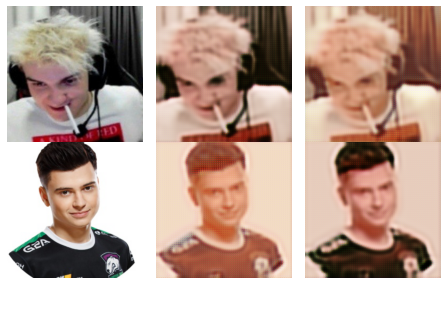

Generator A loss: 0.41998568868383446, Generator B loss: 0.42448882308412106
Discr A loss: 0.21271831729310625, Discr B loss: 0.21347766737354562
Cycle A loss: 2.058070222874905, Cycle B loss: 2.022601569967067


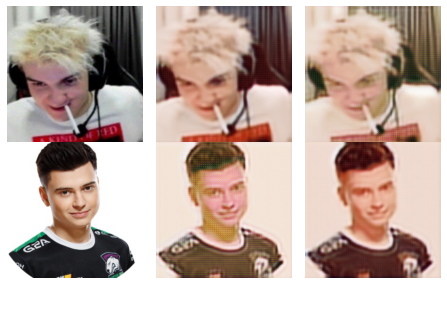

Generator A loss: 0.4849141414812271, Generator B loss: 0.4372458854729825
Discr A loss: 0.19179166932689382, Discr B loss: 0.17954009828415324
Cycle A loss: 1.9263429230832039, Cycle B loss: 1.9023071436171837


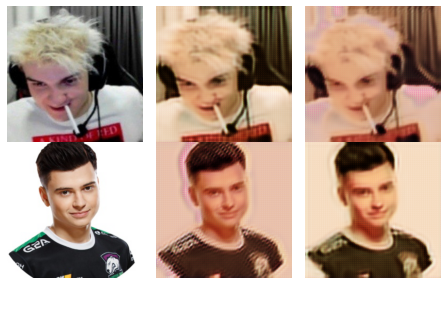

Generator A loss: 0.48845649658048407, Generator B loss: 0.4385258990082335
Discr A loss: 0.18087502784551457, Discr B loss: 0.17307000017546592
Cycle A loss: 1.839462775879718, Cycle B loss: 1.8227224730430764


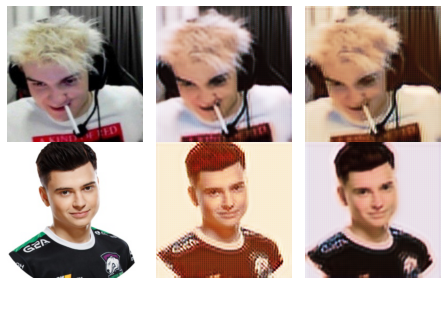

Generator A loss: 0.4604011915782665, Generator B loss: 0.41682308240139737
Discr A loss: 0.1755295326101019, Discr B loss: 0.18751303185807897
Cycle A loss: 1.7681947946548462, Cycle B loss: 1.7630478488638046


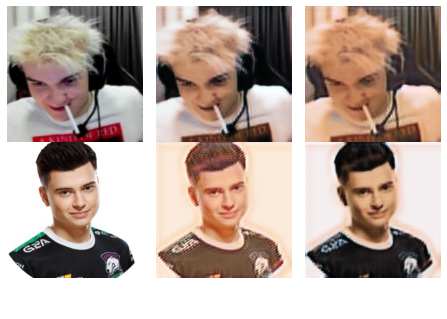

Generator A loss: 0.46309737474360363, Generator B loss: 0.43679935878261605
Discr A loss: 0.1728169656180321, Discr B loss: 0.16903256818335108
Cycle A loss: 1.721828832524888, Cycle B loss: 1.7351953734742833


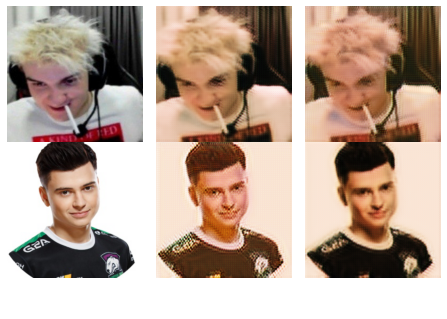

Generator A loss: 0.4505149423679773, Generator B loss: 0.4382226103956395
Discr A loss: 0.17176967510517607, Discr B loss: 0.1710549645125866
Cycle A loss: 1.6487535146956749, Cycle B loss: 1.650670603488354


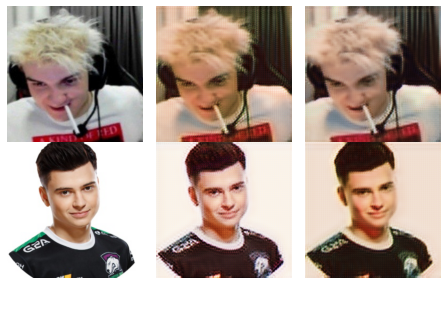

Generator A loss: 0.44131635481372794, Generator B loss: 0.45645128361722254
Discr A loss: 0.1558909665713919, Discr B loss: 0.17372116895115122
Cycle A loss: 1.5999677150807483, Cycle B loss: 1.5803872202305083


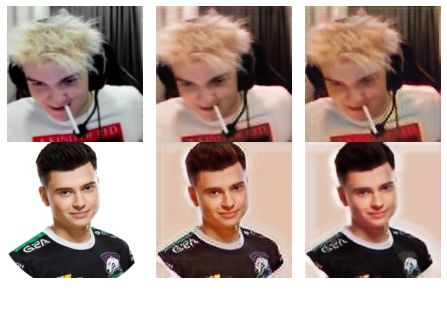

Generator A loss: 0.45170788327430156, Generator B loss: 0.48912465042890385
Discr A loss: 0.15195747639270538, Discr B loss: 0.17346029349781097
Cycle A loss: 1.5712168817824506, Cycle B loss: 1.551134713913532


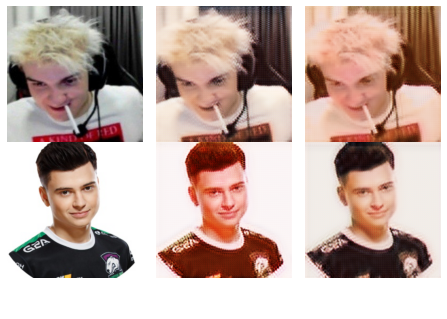

Generator A loss: 0.43117738347104256, Generator B loss: 0.4666775749401843
Discr A loss: 0.14869799907220171, Discr B loss: 0.17131064914642496
Cycle A loss: 1.53452807918508, Cycle B loss: 1.515775741414821


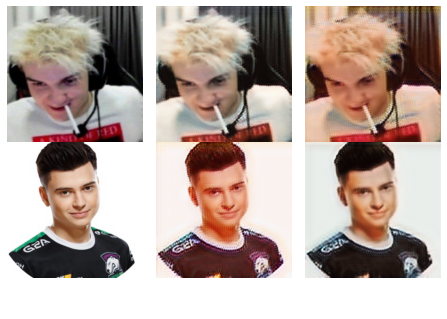

Generator A loss: 0.4636818528016831, Generator B loss: 0.45230295937112036
Discr A loss: 0.14979604582520242, Discr B loss: 0.16246864115621182
Cycle A loss: 1.522102090399316, Cycle B loss: 1.4820419245577874


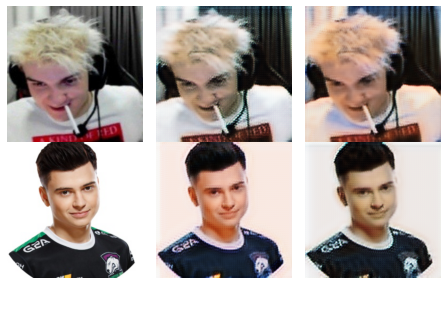

Generator A loss: 0.4878734146343901, Generator B loss: 0.4779676250954892
Discr A loss: 0.14520741911961677, Discr B loss: 0.14877188556054805
Cycle A loss: 1.4416802084192317, Cycle B loss: 1.4382497062074378


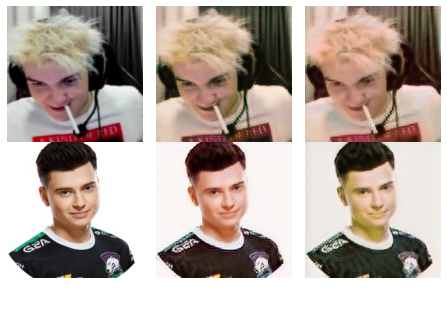

Generator A loss: 0.4445237993559939, Generator B loss: 0.47759173068594424
Discr A loss: 0.14753577035475285, Discr B loss: 0.16155821796744427
Cycle A loss: 1.4661117246810427, Cycle B loss: 1.41406495292136


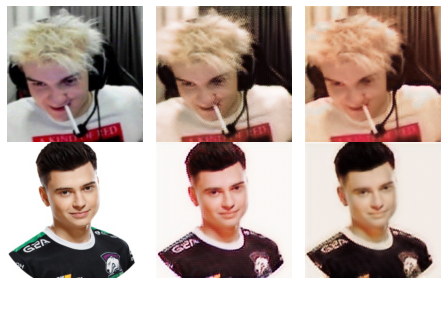

Generator A loss: 0.43642065271418146, Generator B loss: 0.4671900657580254
Discr A loss: 0.14780059399756978, Discr B loss: 0.16393410747355602
Cycle A loss: 1.4025062474798649, Cycle B loss: 1.3812589906631632


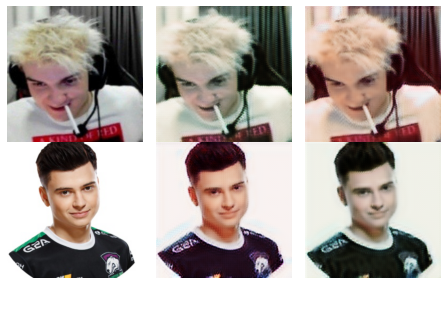

Generator A loss: 0.4453803484110122, Generator B loss: 0.471389697935987
Discr A loss: 0.1406027560538434, Discr B loss: 0.15950929216564969
Cycle A loss: 1.371810220657511, Cycle B loss: 1.361045465824452


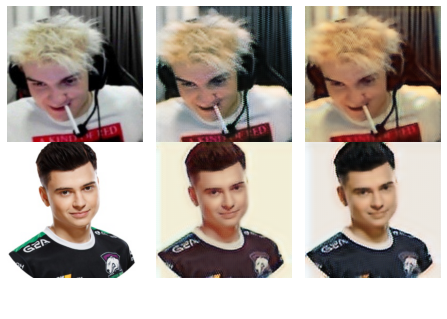

Generator A loss: 0.44703780837515567, Generator B loss: 0.490036781385858
Discr A loss: 0.1374454032074898, Discr B loss: 0.16072796410385598
Cycle A loss: 1.3922891791830672, Cycle B loss: 1.3550358670823117


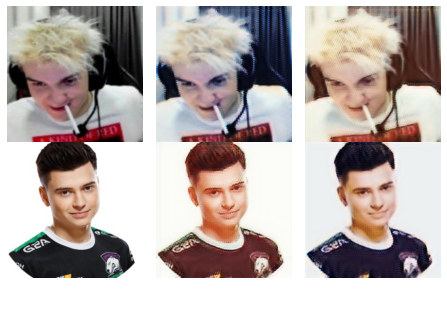

Generator A loss: 0.4357933648564714, Generator B loss: 0.47387257991953097
Discr A loss: 0.15232213830694238, Discr B loss: 0.15812983736395836
Cycle A loss: 1.3438206834996, Cycle B loss: 1.2935303751458513


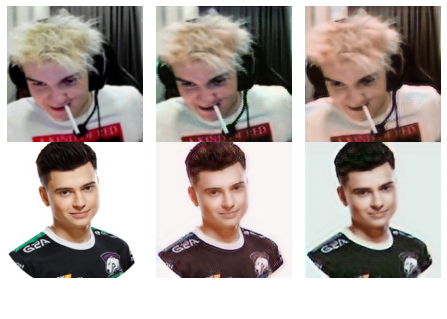

Generator A loss: 0.45018910775159265, Generator B loss: 0.4856926438022167
Discr A loss: 0.14373840762579695, Discr B loss: 0.15794503111788566
Cycle A loss: 1.3468540047077422, Cycle B loss: 1.3132926004998227


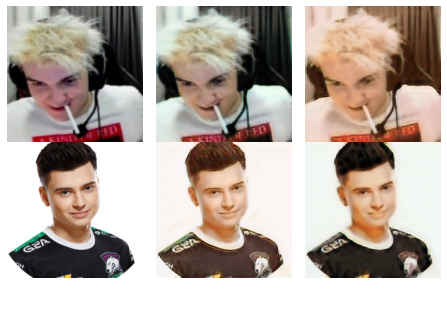

Generator A loss: 0.4412890001814416, Generator B loss: 0.46171818185359875
Discr A loss: 0.15296421691458276, Discr B loss: 0.15732613234443868
Cycle A loss: 1.2979953344832076, Cycle B loss: 1.2737283128373167


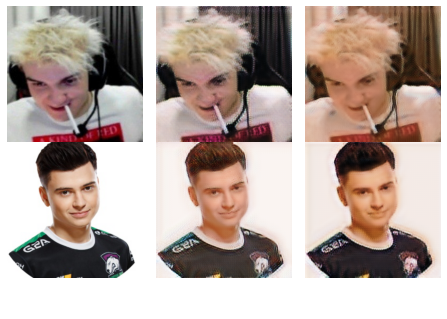

Generator A loss: 0.464813647514328, Generator B loss: 0.4800895111992004
Discr A loss: 0.14992343041491002, Discr B loss: 0.15208316708498812
Cycle A loss: 1.3192978879238697, Cycle B loss: 1.2909186312492857


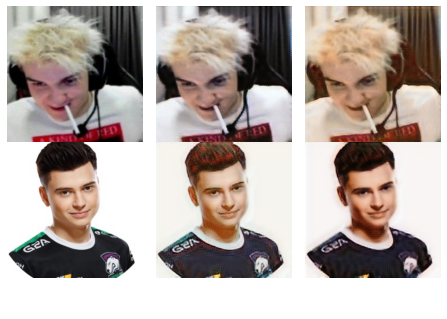

Generator A loss: 0.4660089793040397, Generator B loss: 0.4718172823495053
Discr A loss: 0.14846681438862008, Discr B loss: 0.14573120064240822
Cycle A loss: 1.2620902753890828, Cycle B loss: 1.237081529992692


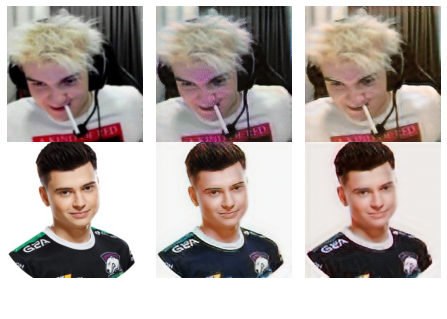

Generator A loss: 0.46613825220376887, Generator B loss: 0.4894004607454259
Discr A loss: 0.13860450490040982, Discr B loss: 0.14968654589450106
Cycle A loss: 1.2510136449590643, Cycle B loss: 1.2143274502551302


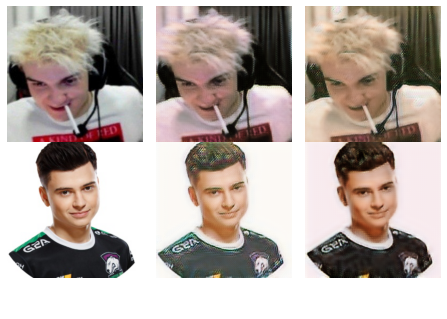

Generator A loss: 0.4562841774618372, Generator B loss: 0.492123663393741
Discr A loss: 0.1492872273985376, Discr B loss: 0.16053928407899876
Cycle A loss: 1.2196976187381339, Cycle B loss: 1.207326117474982


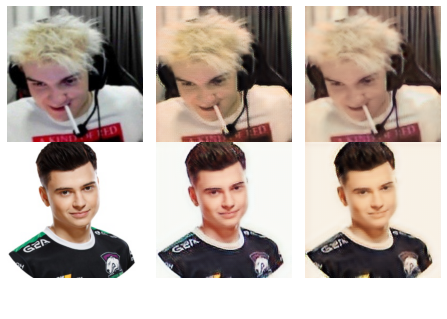

Generator A loss: 0.4467058734373843, Generator B loss: 0.634079374151027
Discr A loss: 0.3827496801205772, Discr B loss: 0.15407322543732663
Cycle A loss: 1.2036456379484624, Cycle B loss: 1.1744870786971233


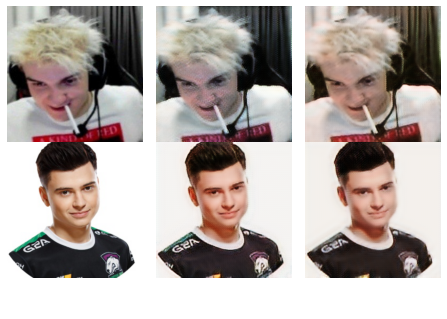

Generator A loss: 0.46064502869514706, Generator B loss: 0.3338723953099961
Discr A loss: 0.22012291661602384, Discr B loss: 0.1504006101412976
Cycle A loss: 1.1940451426708951, Cycle B loss: 1.173424251028832


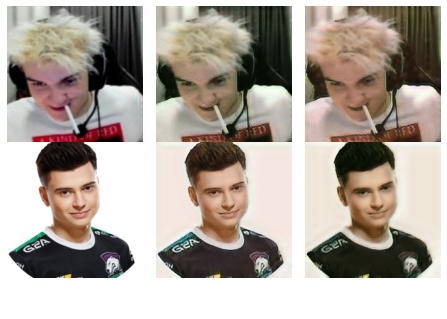

Generator A loss: 0.4583308516664708, Generator B loss: 0.35366272428568374
Discr A loss: 0.2115309475584233, Discr B loss: 0.15610553341660094
Cycle A loss: 1.1428970750342025, Cycle B loss: 1.121664290478889


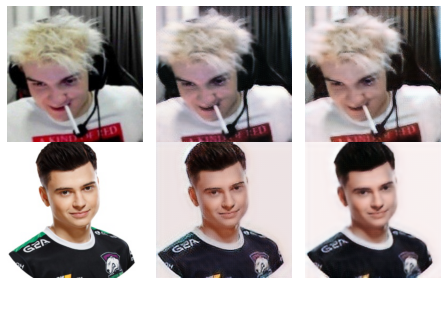

Generator A loss: 0.45279480891024815, Generator B loss: 0.372206770168974
Discr A loss: 0.20039942220170448, Discr B loss: 0.15820736476081482
Cycle A loss: 1.1496768182896553, Cycle B loss: 1.142842300648385


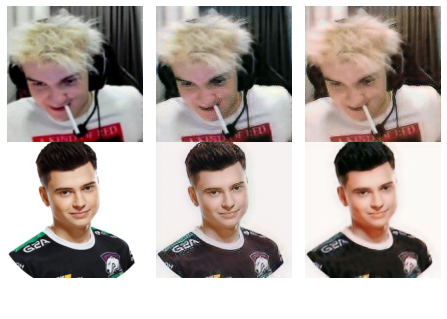

Generator A loss: 0.45796647128906653, Generator B loss: 0.39732242832158476
Discr A loss: 0.1794509323670509, Discr B loss: 0.15222877468517487
Cycle A loss: 1.148956822080815, Cycle B loss: 1.123701422772509


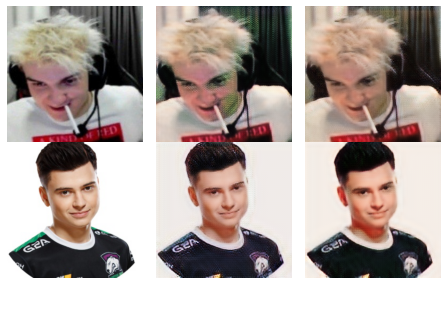

Generator A loss: 0.45071336522381356, Generator B loss: 0.4291890790487858
Discr A loss: 0.16115736764796237, Discr B loss: 0.15265355151384435
Cycle A loss: 1.1307061111673395, Cycle B loss: 1.1187231832362237


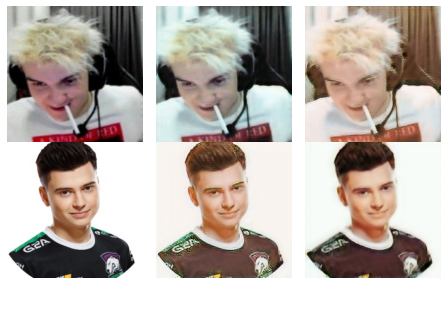

Generator A loss: 0.45734633036116334, Generator B loss: 0.45680988063203526
Discr A loss: 0.15413763394698182, Discr B loss: 0.15047476626140005
Cycle A loss: 1.121564919390577, Cycle B loss: 1.109171281469629


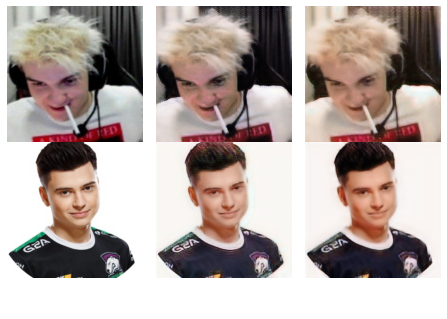

Generator A loss: 0.47574267805890835, Generator B loss: 0.4832215556438933
Discr A loss: 0.15251145748064873, Discr B loss: 0.1501428062611438
Cycle A loss: 0.9509223344478202, Cycle B loss: 0.9393813118021539


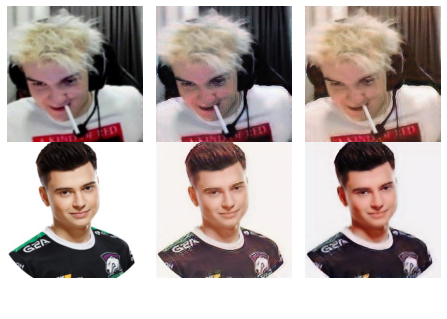

Generator A loss: 0.48531772430906905, Generator B loss: 0.4809465573189106
Discr A loss: 0.14780698239486267, Discr B loss: 0.14989825663097361
Cycle A loss: 0.9247917740903002, Cycle B loss: 0.9369520689578766


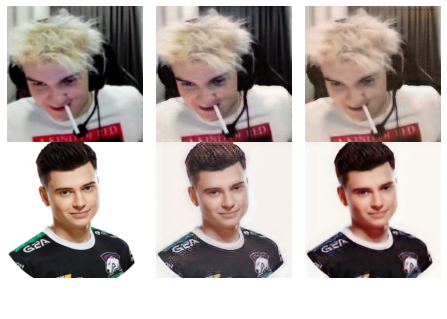

Generator A loss: 0.4934927928954997, Generator B loss: 0.4845771540986731
Discr A loss: 0.14509139152917455, Discr B loss: 0.14827743592731496
Cycle A loss: 0.9140195422984184, Cycle B loss: 0.9146614866053805


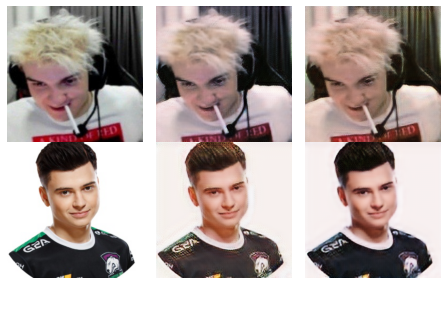

Generator A loss: 0.490931496087541, Generator B loss: 0.4917636933795949
Discr A loss: 0.14574304779476308, Discr B loss: 0.14365844810579687
Cycle A loss: 0.9080986809223256, Cycle B loss: 0.9091456864742522


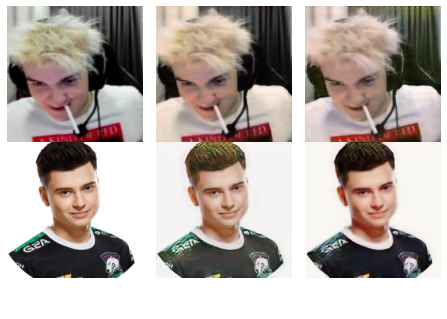

Generator A loss: 0.502904986162135, Generator B loss: 0.4987373927172194
Discr A loss: 0.13985071957428405, Discr B loss: 0.14375069583667086
Cycle A loss: 0.8988040464989683, Cycle B loss: 0.9003259942886678


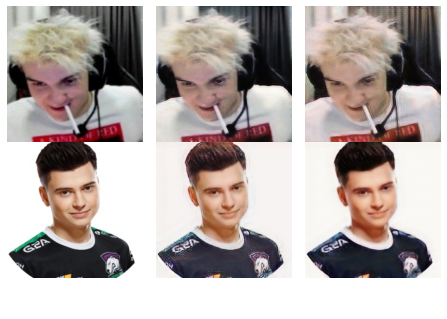

Generator A loss: 0.5003367578412624, Generator B loss: 0.502672470028096
Discr A loss: 0.14213704311467232, Discr B loss: 0.1396588943106063
Cycle A loss: 0.8996964687996722, Cycle B loss: 0.8901205671594498


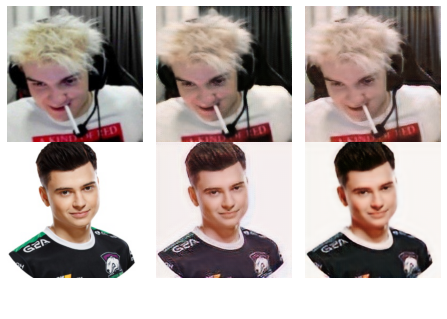

Generator A loss: 0.5023499665900748, Generator B loss: 0.503452387261898
Discr A loss: 0.13876744283640638, Discr B loss: 0.13728592124708155
Cycle A loss: 0.8736980562514447, Cycle B loss: 0.8945635590147465


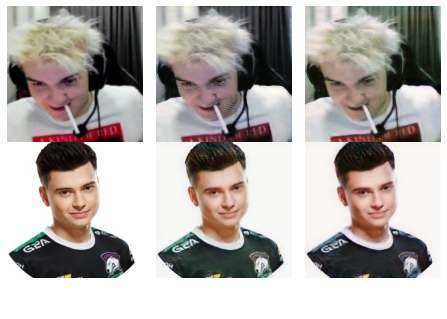

Generator A loss: 0.5075208171568019, Generator B loss: 0.526373869053861
Discr A loss: 0.14102162607806795, Discr B loss: 0.13754154565803547
Cycle A loss: 0.8623069552665061, Cycle B loss: 0.8706976398508599


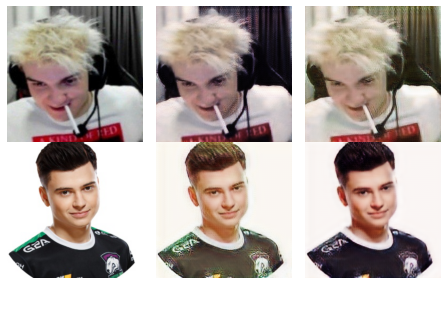

Generator A loss: 0.702363813430705, Generator B loss: 0.535823691113198
Discr A loss: 0.13479191933540588, Discr B loss: 0.5716576189436811
Cycle A loss: 0.8830963976839755, Cycle B loss: 0.8907156731220002


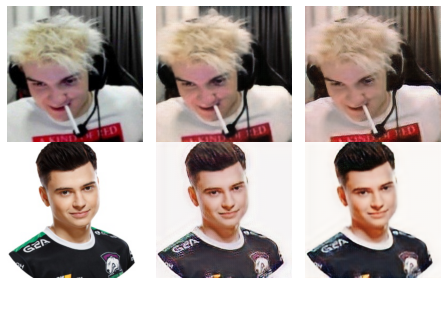

Generator A loss: 0.28863622653991616, Generator B loss: 0.5329261128255661
Discr A loss: 0.13356002114237622, Discr B loss: 0.2409009650032571
Cycle A loss: 0.8187709268103255, Cycle B loss: 0.8431141229386026


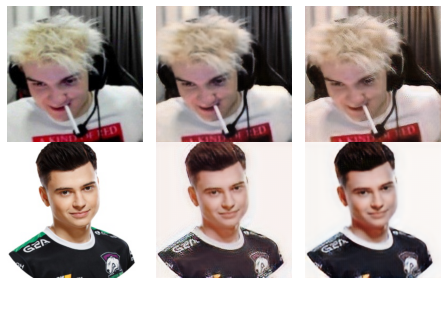

Generator A loss: 0.3115791401330461, Generator B loss: 0.5377014646821834
Discr A loss: 0.13380256629687676, Discr B loss: 0.23457132089645305
Cycle A loss: 0.8212545450697554, Cycle B loss: 0.8370177053390665


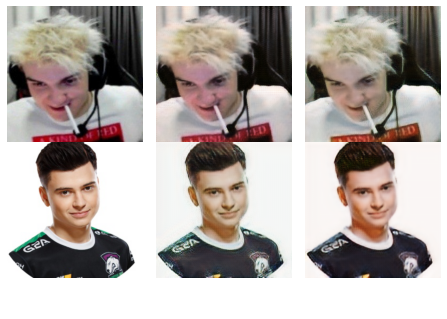

Generator A loss: 0.33422102319433333, Generator B loss: 0.5318565970088573
Discr A loss: 0.132929636022829, Discr B loss: 0.23334983156082478
Cycle A loss: 0.7985080749430555, Cycle B loss: 0.8223981413435428


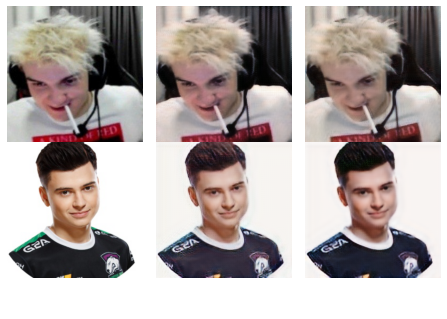

Generator A loss: 0.34189343788522353, Generator B loss: 0.5551078303697261
Discr A loss: 0.12845738544426066, Discr B loss: 0.23025777454071858
Cycle A loss: 0.8027408995526902, Cycle B loss: 0.82590749060854


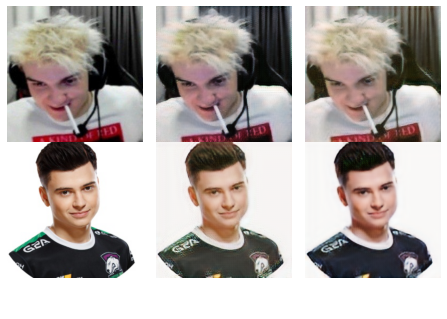

Generator A loss: 0.34953094498908266, Generator B loss: 0.5424403607845306
Discr A loss: 0.13132994038627502, Discr B loss: 0.22809089916817685
Cycle A loss: 0.7950553965061269, Cycle B loss: 0.8143414948848968


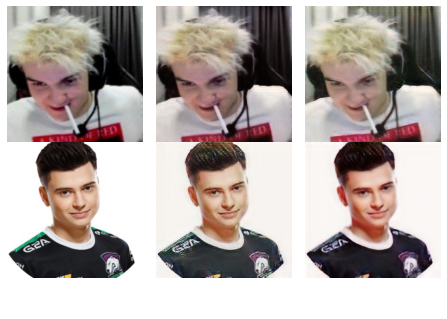

Generator A loss: 0.3592359231507525, Generator B loss: 0.5473456607854112
Discr A loss: 0.12397856032277675, Discr B loss: 0.226010426022905
Cycle A loss: 0.7846321425539382, Cycle B loss: 0.8118991182205525


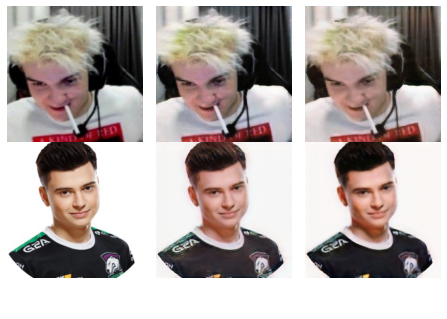

Generator A loss: 0.3600562497656396, Generator B loss: 0.5553560956995538
Discr A loss: 0.12437687215018779, Discr B loss: 0.2277185765352655
Cycle A loss: 0.7832547314623569, Cycle B loss: 0.803145020566088


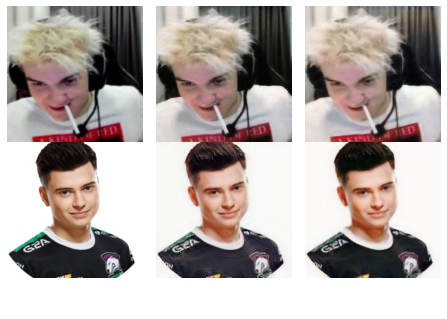

Generator A loss: 0.365648045692038, Generator B loss: 0.5538697901399846
Discr A loss: 0.12619612123420898, Discr B loss: 0.22745367580271783
Cycle A loss: 0.7689715644146534, Cycle B loss: 0.7989760269509986


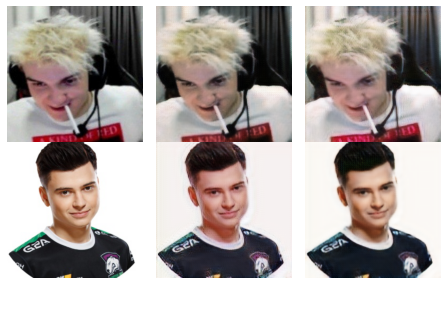

Generator A loss: 0.3696920349559885, Generator B loss: 0.5544591476625584
Discr A loss: 0.12296323158005451, Discr B loss: 0.22249116571025646
Cycle A loss: 0.7570812714860794, Cycle B loss: 0.7923046829852652


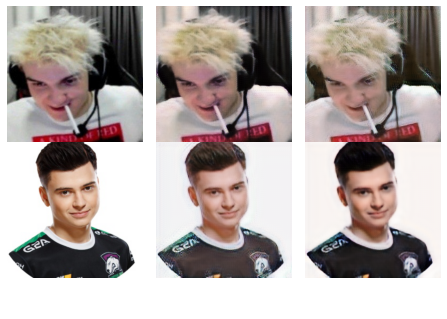

Generator A loss: 0.3710469274127737, Generator B loss: 0.5442600091404103
Discr A loss: 0.12301868680626787, Discr B loss: 0.2220152626646326
Cycle A loss: 0.7548239551960154, Cycle B loss: 0.7831589607482261


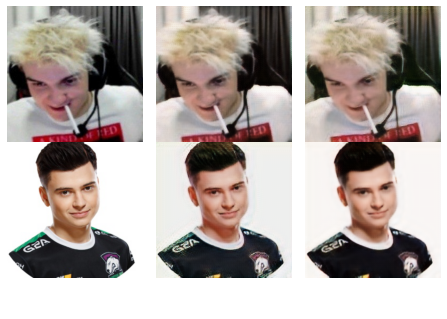

Generator A loss: 0.37686528658613244, Generator B loss: 0.5634143875000325
Discr A loss: 0.12230745769561606, Discr B loss: 0.22046003148276755
Cycle A loss: 0.759060841671964, Cycle B loss: 0.7864704847335815


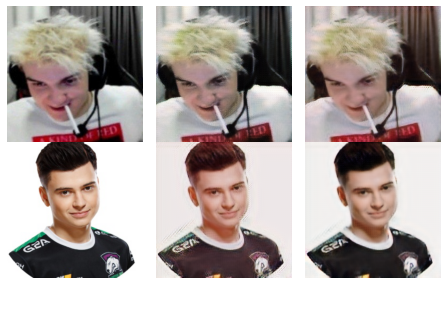

Generator A loss: 0.37899492015229896, Generator B loss: 0.5542152462487525
Discr A loss: 0.12201967678488569, Discr B loss: 0.2203253593533597
Cycle A loss: 0.7444524650878095, Cycle B loss: 0.7768399274095575


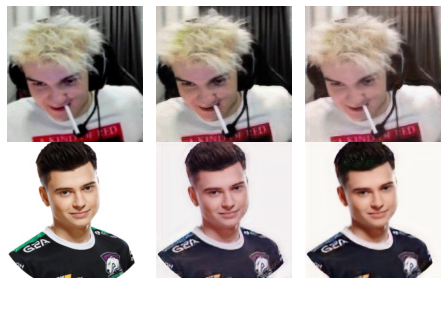

Generator A loss: 0.374167789296901, Generator B loss: 0.5564821943323663
Discr A loss: 0.12337860268481235, Discr B loss: 0.21639676182828052
Cycle A loss: 0.7350855574962941, Cycle B loss: 0.7731321266356935


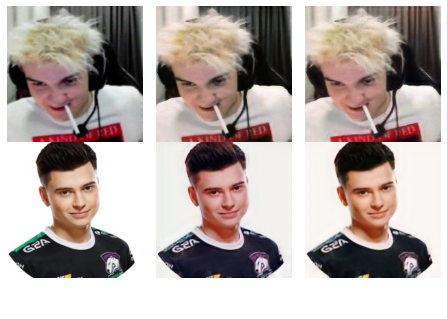

Generator A loss: 0.3774039124554776, Generator B loss: 0.5627073443316398
Discr A loss: 0.1195494459664568, Discr B loss: 0.21732145481287166
Cycle A loss: 0.7557631008168484, Cycle B loss: 0.7830364047212803


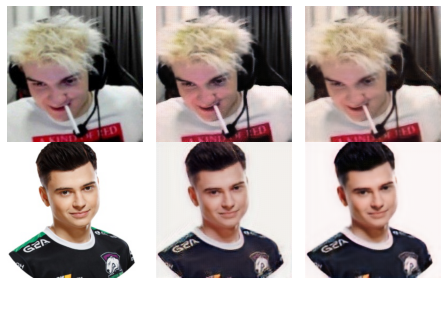

Generator A loss: 0.38770736817349777, Generator B loss: 0.5639611746402498
Discr A loss: 0.12000580877065659, Discr B loss: 0.21491433749807642
Cycle A loss: 0.747527423944879, Cycle B loss: 0.7747778555180164


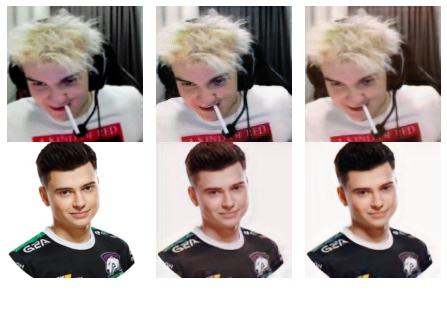

Generator A loss: 0.38953979693828744, Generator B loss: 0.5649134027831098
Discr A loss: 0.12487441642170256, Discr B loss: 0.21119954912586414
Cycle A loss: 0.7376445009353313, Cycle B loss: 0.7796097390195157


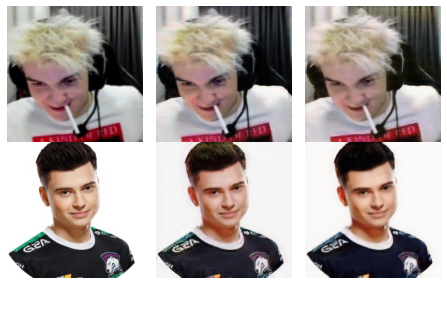

Generator A loss: 0.3861664599560677, Generator B loss: 0.5703186653871486
Discr A loss: 0.11941226995054711, Discr B loss: 0.20821120605823842
Cycle A loss: 0.741757113629199, Cycle B loss: 0.7682601368173639


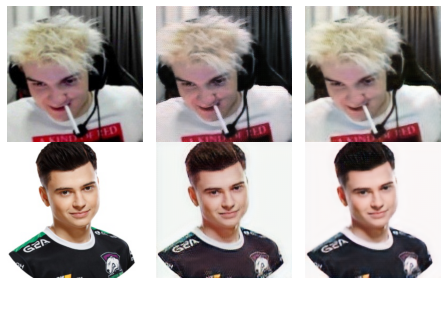

Generator A loss: 0.3934046006107584, Generator B loss: 0.5702313605141133
Discr A loss: 0.12324779412530838, Discr B loss: 0.203160985131213
Cycle A loss: 0.71835374857517, Cycle B loss: 0.75304843910197


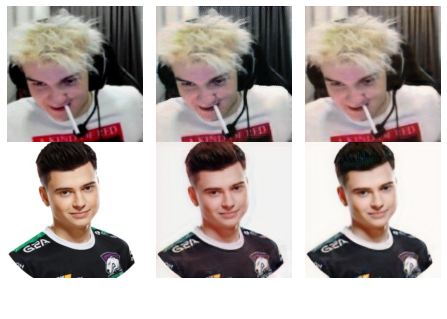

Generator A loss: 0.39622717968961024, Generator B loss: 0.5706572188341871
Discr A loss: 0.11357204731791577, Discr B loss: 0.19219930476330696
Cycle A loss: 0.7323012354526114, Cycle B loss: 0.7679170205238017


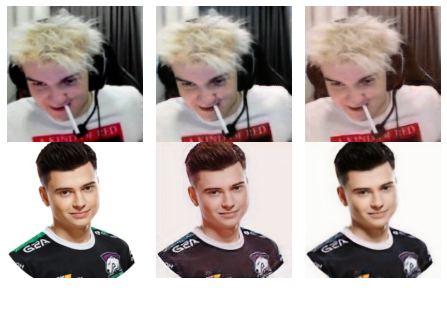

Generator A loss: 0.3973336419526567, Generator B loss: 0.5665665642061132
Discr A loss: 0.11614583900317232, Discr B loss: 0.20459398893599814
Cycle A loss: 0.7324194896728434, Cycle B loss: 0.7614402438731904


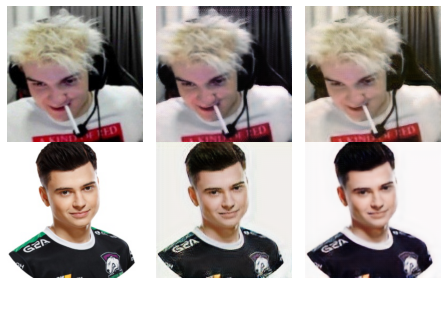

Generator A loss: 0.41299446729269434, Generator B loss: 0.5708806503960426
Discr A loss: 0.12113005426969935, Discr B loss: 0.1762028327647676
Cycle A loss: 0.7305080870364574, Cycle B loss: 0.7655039107545893


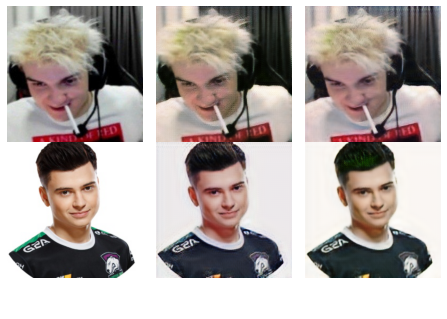

Generator A loss: 0.45682951132667826, Generator B loss: 1.237002753006651
Discr A loss: 0.969166655600705, Discr B loss: 0.16736779710713853
Cycle A loss: 0.7557544211123852, Cycle B loss: 0.7841676973282022


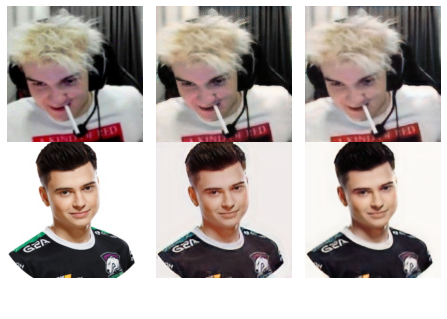

Generator A loss: 0.4742642934017993, Generator B loss: 0.2723797484281215
Discr A loss: 0.2548525792487124, Discr B loss: 0.15088575271532892
Cycle A loss: 0.6198415260365668, Cycle B loss: 0.641708189375857


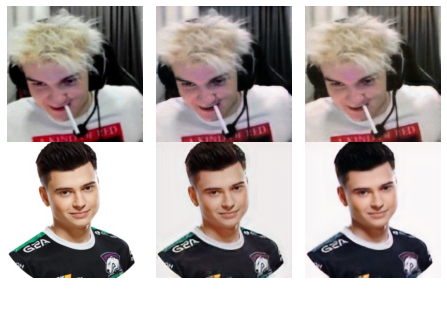

Generator A loss: 0.47998548020073706, Generator B loss: 0.2766991634318169
Discr A loss: 0.24797304038037646, Discr B loss: 0.14825040777312948
Cycle A loss: 0.593891785373079, Cycle B loss: 0.6137189768730326


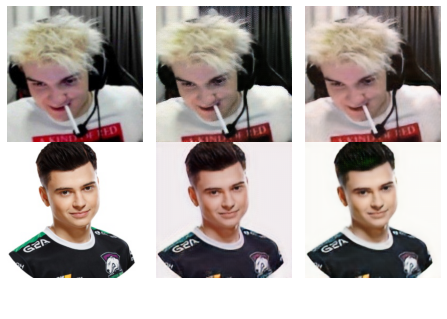

Generator A loss: 0.5088205120982008, Generator B loss: 0.28157993631160005
Discr A loss: 0.24392313437258945, Discr B loss: 0.14337268780837667
Cycle A loss: 0.5888183473272527, Cycle B loss: 0.5937857063526802


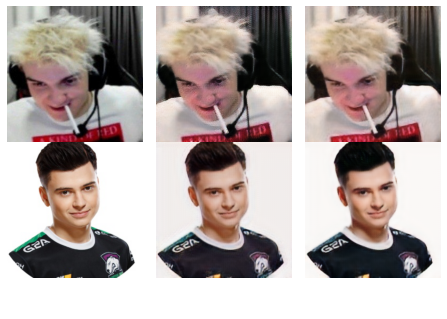

Generator A loss: 0.5109816790261167, Generator B loss: 0.28794750203477576
Discr A loss: 0.24173602341337408, Discr B loss: 0.13809285867721477
Cycle A loss: 0.5900814544647298, Cycle B loss: 0.6000025003514391


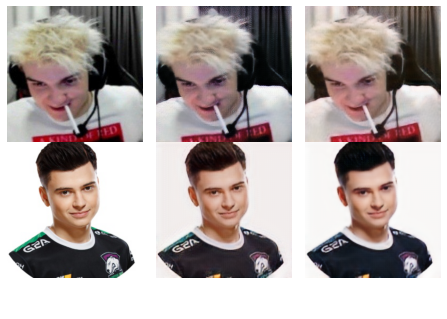

Generator A loss: 0.5329232407377121, Generator B loss: 0.2906214268283641
Discr A loss: 0.24307486789023622, Discr B loss: 0.1289227212363101
Cycle A loss: 0.5902964260983974, Cycle B loss: 0.5930063308553493


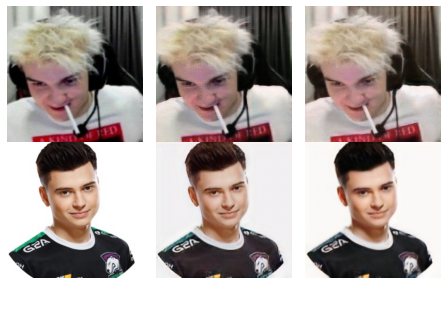

Generator A loss: 0.5387067605840399, Generator B loss: 0.29440132284418064
Discr A loss: 0.24567097298642424, Discr B loss: 0.13019341561705508
Cycle A loss: 0.5939425495076687, Cycle B loss: 0.5868045123333626


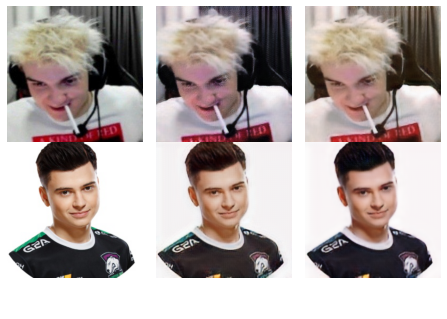

Generator A loss: 0.5365841864905458, Generator B loss: 0.29825159285930875
Discr A loss: 0.2469666910932419, Discr B loss: 0.12962521349496028
Cycle A loss: 0.5969695155924939, Cycle B loss: 0.5970776568067835


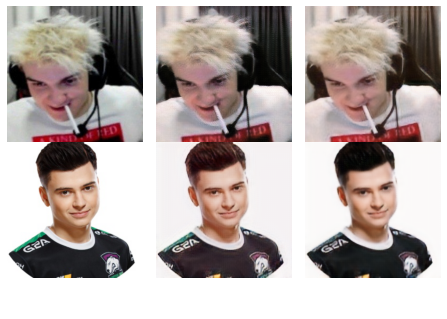

Generator A loss: 0.5639573406665883, Generator B loss: 0.2996987629444041
Discr A loss: 0.2500635291667695, Discr B loss: 0.1208961289613805
Cycle A loss: 0.5906637502477524, Cycle B loss: 0.5867951544041329


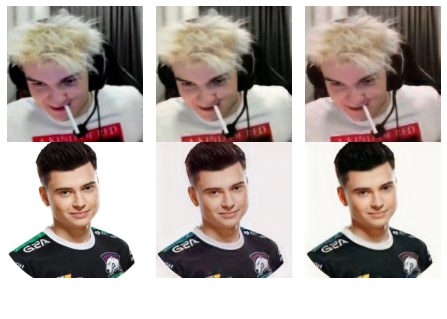

Generator A loss: 0.5695124454003699, Generator B loss: 0.3027072793625771
Discr A loss: 0.2523093526667737, Discr B loss: 0.12021142017651111
Cycle A loss: 0.5984601493845595, Cycle B loss: 0.5884520654982709


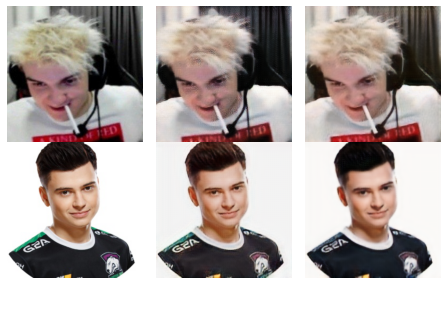

Generator A loss: 0.5865030799774413, Generator B loss: 0.30359886301324723
Discr A loss: 0.25396955958072176, Discr B loss: 0.11684299548889729
Cycle A loss: 0.5960767678757931, Cycle B loss: 0.5856121736638089


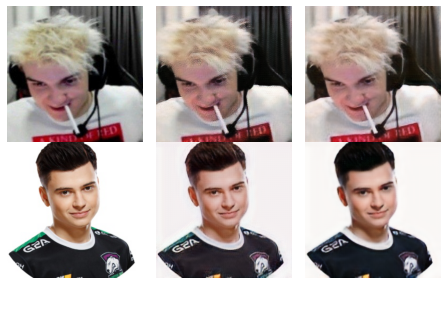

Generator A loss: 0.5768642319009659, Generator B loss: 0.30386945630641693
Discr A loss: 0.25051834158440855, Discr B loss: 0.11832170554615082
Cycle A loss: 0.5978786644783426, Cycle B loss: 0.5796427584709005


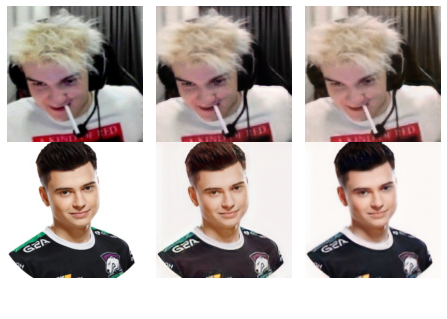

Generator A loss: 0.5810362921750292, Generator B loss: 0.3086283748454236
Discr A loss: 0.25598625432937705, Discr B loss: 0.11803836962009998
Cycle A loss: 0.5951748387610659, Cycle B loss: 0.5730415079187839


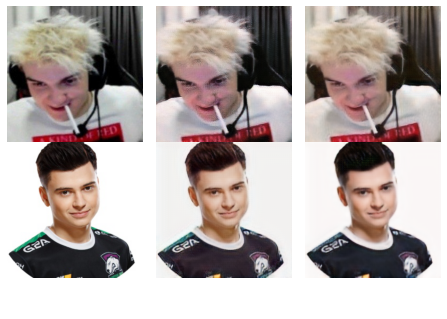

Generator A loss: 0.8358843266329867, Generator B loss: 0.3045342761785426
Discr A loss: 0.24578435719013214, Discr B loss: 0.443851872438446
Cycle A loss: 0.6509620269562336, Cycle B loss: 0.6307117548394711


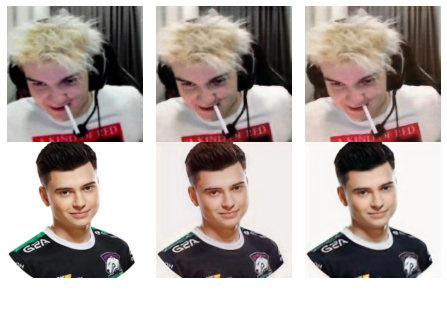

Generator A loss: 0.3376176094121121, Generator B loss: 0.31139543595466207
Discr A loss: 0.24757843226828474, Discr B loss: 0.2256733719021716
Cycle A loss: 0.5709439840722591, Cycle B loss: 0.5723801986968263


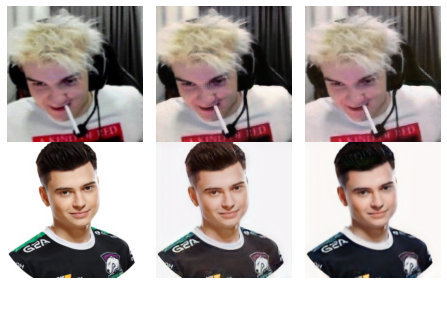

Generator A loss: 0.34019912836399485, Generator B loss: 0.3130829164322386
Discr A loss: 0.24870689181571312, Discr B loss: 0.2221488409853996
Cycle A loss: 0.5442686110100847, Cycle B loss: 0.543462499912749


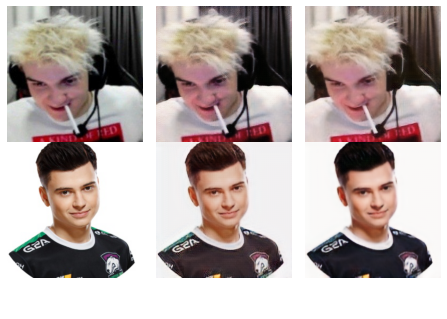

Generator A loss: 0.341322394317769, Generator B loss: 0.3146799703227713
Discr A loss: 0.24882011058482717, Discr B loss: 0.21904899560390634
Cycle A loss: 0.5483612773266244, Cycle B loss: 0.5490788719755538


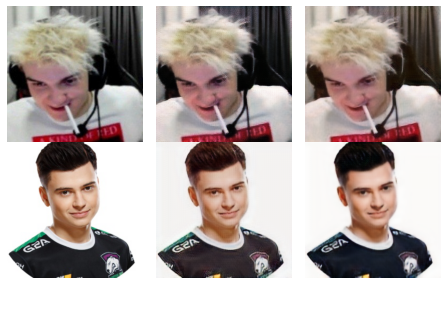

Generator A loss: 0.3503230212533728, Generator B loss: 0.3135373247747726
Discr A loss: 0.24380649448709285, Discr B loss: 0.21442118803871438
Cycle A loss: 0.5414619249232272, Cycle B loss: 0.5448509964537114


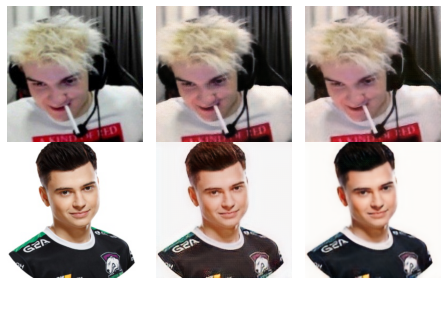

Generator A loss: 0.3607798936519217, Generator B loss: 0.3176817735775988
Discr A loss: 0.24421300171537602, Discr B loss: 0.2083828570677879
Cycle A loss: 0.5494345552109657, Cycle B loss: 0.5495902842663704


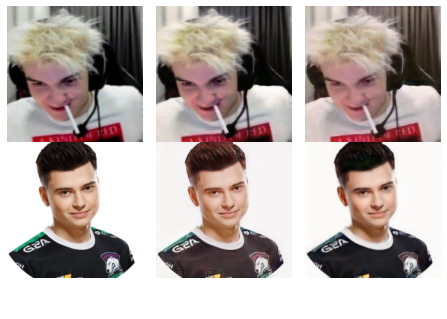

Generator A loss: 0.37513619173080365, Generator B loss: 0.31945622487271086
Discr A loss: 0.24362682636747968, Discr B loss: 0.20338319568557942
Cycle A loss: 0.5476329761616727, Cycle B loss: 0.544478986111093


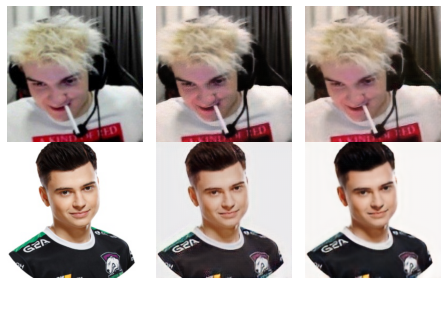

Generator A loss: 0.39408392763518274, Generator B loss: 0.321631199216589
Discr A loss: 0.2412849133319043, Discr B loss: 0.18523768674820026
Cycle A loss: 0.554811515453014, Cycle B loss: 0.5590171712510129


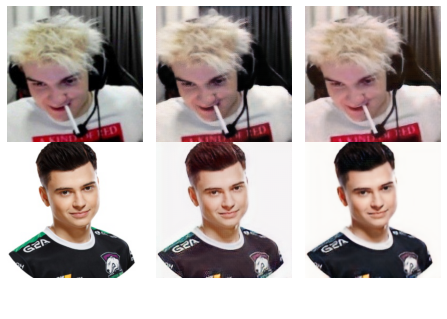

Generator A loss: 0.4344482520793347, Generator B loss: 0.3268704059276175
Discr A loss: 0.2415039491146169, Discr B loss: 0.15732885871795899
Cycle A loss: 0.5534205505188475, Cycle B loss: 0.5550818275898061


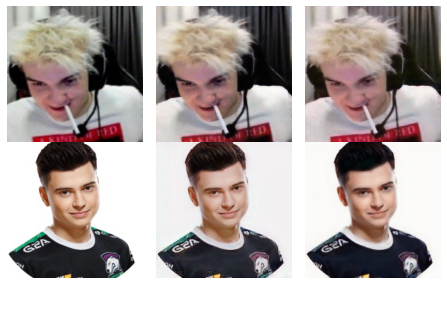

Generator A loss: 0.5046992855503204, Generator B loss: 0.32559072727218585
Discr A loss: 0.23926813678538544, Discr B loss: 0.1409384608585784
Cycle A loss: 0.5636118786132082, Cycle B loss: 0.5625460958227199


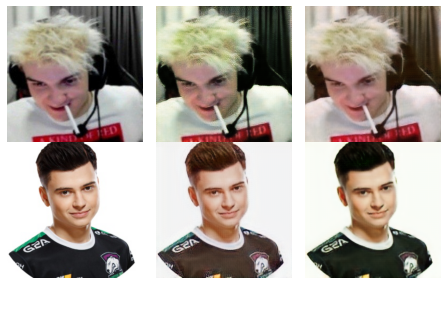

Generator A loss: 0.528122129719308, Generator B loss: 0.3317050183390049
Discr A loss: 0.2365117132663727, Discr B loss: 0.12729508702425246
Cycle A loss: 0.5701397930053954, Cycle B loss: 0.5671763582432524


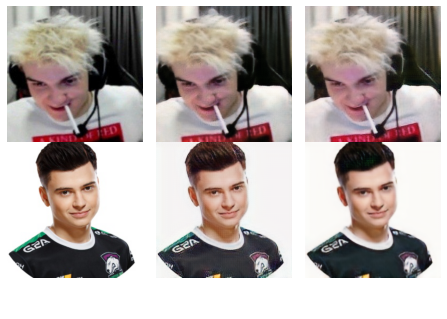

Generator A loss: 0.5520889930268551, Generator B loss: 0.3382225239530523
Discr A loss: 0.23639010400214094, Discr B loss: 0.1260546550471732
Cycle A loss: 0.5737905327309953, Cycle B loss: 0.5593632991009571


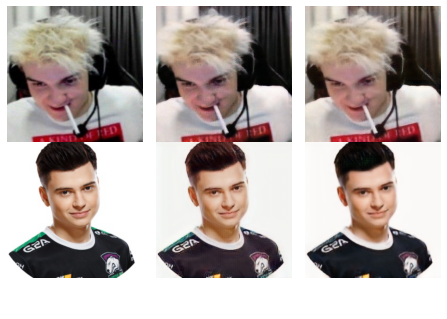

Generator A loss: 0.5563409865536588, Generator B loss: 0.33204512589789453
Discr A loss: 0.23456968493918154, Discr B loss: 0.12269873127658316
Cycle A loss: 0.5692222526732912, Cycle B loss: 0.5544909337733654


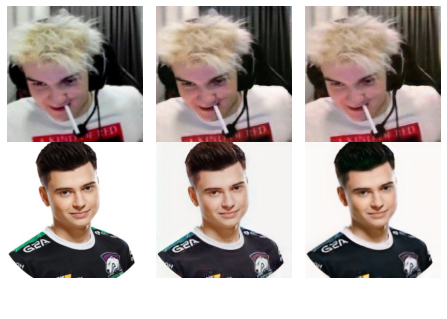

Generator A loss: 0.5518257097360936, Generator B loss: 0.33722326837955635
Discr A loss: 0.22605574847535884, Discr B loss: 0.11942635180151209
Cycle A loss: 0.5778610669552011, Cycle B loss: 0.5663800268731218


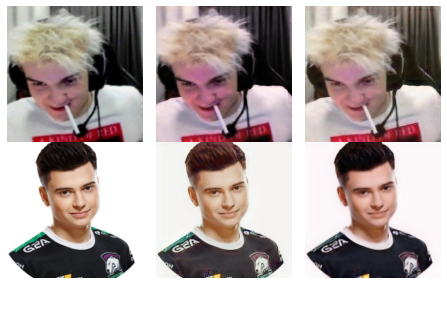

In [0]:
G_A_loss, G_B_loss, D_A_loss, D_B_loss, cycle_A_loss, cycle_B_loss = train(100)

In [0]:
if not os.path.exists('output/A'):
    os.makedirs('output/A')
if not os.path.exists('output/B'):
    os.makedirs('output/B')

In [0]:
def plot_test_result(test_images, length, test_class, fig_size=(20, 10)):
    fig, axes = plt.subplots(length // 5, length // (length // 5), figsize=fig_size)
    

    for ax, img in zip(axes.flatten(), test_images):
        ax.axis('off')
        ax.set_adjustable('box')
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    if test_class == 'A':
        title = 'Brunette to blonde'.format(test_class)
        fig.text(0.5, 0.04, title, ha='center', fontsize=12, color='white')
    else:
        title = 'Blonde to brunette'.format(test_class)
        fig.text(0.5, 0.04, title, ha='center', fontsize=12, color='white')

    plt.show()

Generated images 0020 of 0020


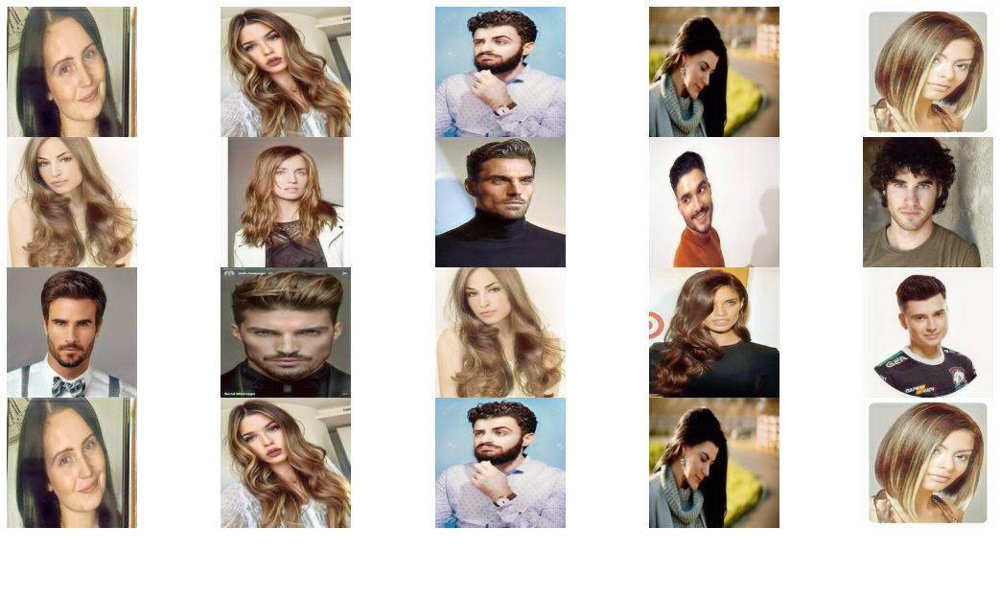

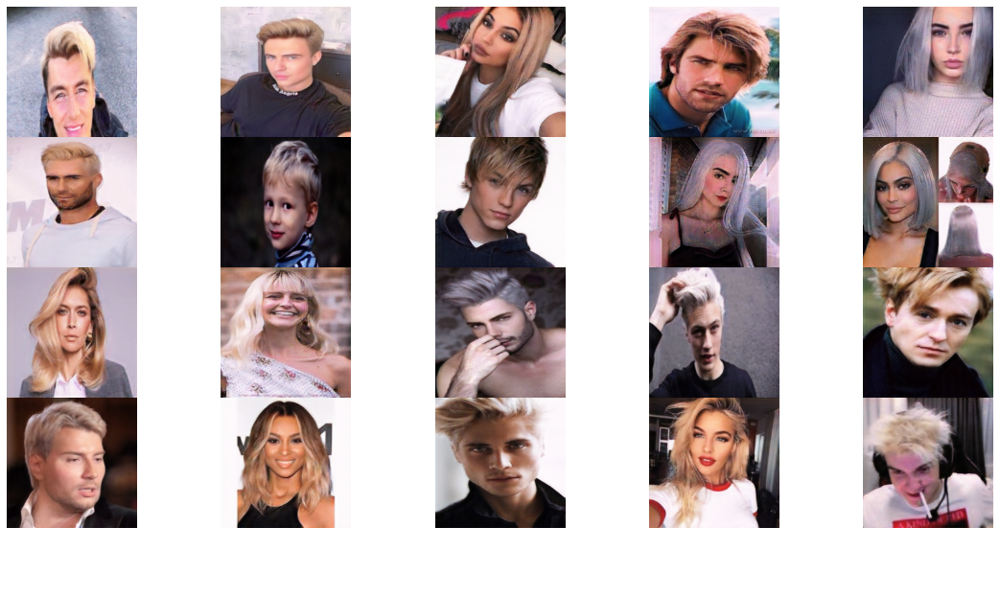

In [50]:
import sys

netG_A2B.eval()
netG_B2A.eval()
test_A = []
test_B = []

for i, batch in enumerate(dataloader_test):
    # Set model input
    real_A = batch['A'].to(device)
    real_B = batch['B'].to(device)

    # Generate output
    with torch.no_grad():
        fake_B = to_np(netG_A2B(real_A))
        fake_A = to_np(netG_B2A(real_B))

        fake_B = fake_B.squeeze()
        fake_B = (((fake_B - fake_B.min()) * 255) / (fake_B.max() - fake_B.min())).transpose(1, 2, 0).astype(np.uint8)
        test_B.append(fake_B)
        fake_B = Image.fromarray(fake_B)

        fake_A = fake_A.squeeze()
        fake_A = (((fake_A - fake_A.min()) * 255) / (fake_A.max() - fake_A.min())).transpose(1, 2, 0).astype(np.uint8)
        test_A.append(fake_A)
        fake_A = Image.fromarray(fake_A)

    # Save image files
    fake_A.save('output/A/%04d.png' % (i+1))
    fake_B.save('output/B/%04d.png' % (i+1))

    sys.stdout.write('\rGenerated images %04d of %04d' % (i+1, len(dataloader_test)))

sys.stdout.write('\n')

plot_test_result(test_A, len(test_A), 'A')
plot_test_result(test_B, len(test_B), 'B')
###################################